<a href="https://colab.research.google.com/github/azfarkhoja305/GANs/blob/attention_init/notebooks/attention_init.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Initialization

In [ ]:
# Check GPU
!nvidia-smi

Mon Apr 12 00:04:42 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.67       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   32C    P0    23W / 300W |      0MiB / 16160MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import os
import sys
import pdb
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from matplotlib import animation, rc
from tqdm.auto import tqdm

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torchvision.utils as vutils

from torchsummary import summary
from types import SimpleNamespace

In [ ]:
!git clone --single-branch --branch attention_init https://github.com/azfarkhoja305/GANs.git

Cloning into 'GANs'...
remote: Enumerating objects: 367, done.
remote: Counting objects: 100% (367/367), done.
remote: Compressing objects: 100% (277/277), done.
remote: Total 367 (delta 204), reused 197 (delta 89), pack-reused 0
Receiving objects: 100% (367/367), 115.65 MiB | 15.39 MiB/s, done.
Resolving deltas: 100% (204/204), done.


In [ ]:
Path.ls = lambda x: list(x.iterdir())
if Path('./GANs').exists():
    sys.path.insert(0,'./GANs')

In [ ]:
from models.transformer_generator import TGenerator
from models.ViT_discriminator import Discriminator
from utils.utils import check_gpu, display_images, set_seed
from utils.checkpoint import Checkpoint
from utils.loss import wgangp_eps_loss
from utils.datasets import ImageDataset
%load_ext autoreload
%autoreload 2

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
gdrive = Path('drive/MyDrive')

# Create a required checkpoint instance. 
# If does not exists, Checkpoint class will create one.
ckp_folder = gdrive/'temporary_checkpoint'

Mounted at /content/drive


In [ ]:
# seed notebook
set_seed(seed=123)
device = check_gpu()
print(f'Using device: {device}')

Using device: cuda


In [ ]:
!PYTHONPATH=./GANs python ./GANs/scripts/create_fid_stats.py -d cifar_10 -t False

Namespace(batch_size=256, dataset='cifar_10', save='fid_stats', train='False')
170499072it [00:05, 29258038.17it/s]                   
Extracting data/cifar_10/cifar-10-python.tar.gz to data/cifar_10
Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth
100% 91.2M/91.2M [00:01<00:00, 61.5MB/s]


# Training

In [ ]:
gen_batch_sz = 64
dis_batch_sz = 32
latent_dims = 1024
lr, beta1, beta2 = 1e-4, 0, 0.999
num_epochs = 100

Files already downloaded and verified


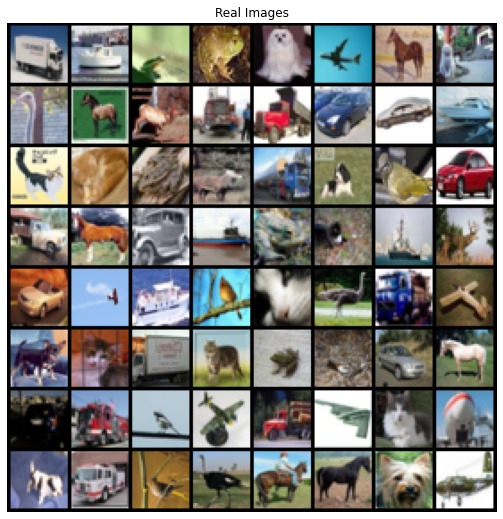

In [ ]:
# Add Horizontal Flip by default
tfms = [transforms.RandomHorizontalFlip()]
dataset =  ImageDataset('cifar_10', batch_sz=dis_batch_sz, tfms=tfms, 
                        num_workers=2, drop_last=True)
display_images(dataset.train_loader)

In [ ]:
Gen = TGenerator(latent_dims=latent_dims, use_att_mask=True).to(device)
fixed_z = torch.randn(gen_batch_sz, latent_dims, device=device)
# summary(Gen,(latent_dims,))

In [ ]:
args = SimpleNamespace(**{"d_depth": 7, "df_dim": 384, "img_size": 32, "patch_size": 8})
Dis = Discriminator(args).to(device)
# summary(Dis,(3,32,32,))

In [ ]:
optG = optim.AdamW(Gen.parameters(), lr=lr, betas=(beta1, beta2))
optD = optim.AdamW(Dis.parameters(), lr=lr, betas=(beta1, beta2))

In [ ]:
loss_logs = {'gen_loss': [], 'dis_loss': []}
img_list = []

In [ ]:
ckp_class = Checkpoint(ckp_folder, max_epochs=num_epochs, num_ckps=7, start_after=0.4)

# check if any existing checkpoint exists, none found hence start_epoch is 0.
# Optimizer states also get saved
Gen, Dis, optG, optD, start_epoch, old_logs = \
                        ckp_class.check_if_exists(Gen, Dis, optG, optD)

loss_logs = old_logs or loss_logs
start_epoch #, loss_logs

0

In [ ]:
# number of prints per epoch 
num = 2
print_at = np.linspace(400, len(dataset.train_loader)-1, num=num, dtype=np.int).tolist()

In [ ]:
for epoch in tqdm(range(start_epoch, num_epochs)):
    for i, data in enumerate(tqdm(dataset.train_loader, leave=False)):
        
        ###########################
        # (1) Update Dis network
        ###########################
        
        ## Train with all-real batch
        Dis.zero_grad()
        real = data[0].to(device)
        output_real = Dis(real).view(-1)

        ## Train with all-fake batch
        dis_z = torch.randn(dis_batch_sz, latent_dims, device=device)
        fake_1 = Gen(dis_z, epoch).detach()
        output_fake_1 = Dis(fake_1).view(-1)

        ## Compute loss and backpropagate
        errD = wgangp_eps_loss(Dis, real, fake_1, 1.0, output_real, output_fake_1)
        errD.backward()
        torch.nn.utils.clip_grad_norm_(Dis.parameters(), 5.0)
        optD.step()

        ###########################
        # (2) Update Gen network
        ###########################
        
        Gen.zero_grad()
        gen_z = torch.randn(gen_batch_sz, latent_dims, device=device)
        fake_2 = Gen(gen_z, epoch)
        output_fake_2 = Dis(fake_2).view(-1)
        errG = -torch.mean(output_fake_2)
        errG.backward()
        torch.nn.utils.clip_grad_norm_(Gen.parameters(), 5.0)
        optG.step()

        ###########################
        # (3) Output
        ###########################

        # Save Losses for plotting later
        loss_logs['gen_loss'].append(errG.item())
        loss_logs['dis_loss'].append(errD.item())

        if i in print_at:
            # Output training stats averged over last 100 iterations
            gen_mean = np.mean(loss_logs['gen_loss'][-100:])
            dis_mean = np.mean(loss_logs['dis_loss'][-100:])
            print(f'[{epoch}/{num_epochs}][{i}/{len(dataset.train_loader)}]\t'
                  f'Loss_D: {round(gen_mean, 4)}\t',
                  f'Loss_G: {round(dis_mean, 4)}')
        
            # Check how the generator is doing by saving G's output on fixed_noise
            with torch.no_grad():
                fixed_fake = Gen(fixed_z).detach().cpu()
            img_list.append(vutils.make_grid(fixed_fake, padding=2, normalize=True))
    
    # Checkpoint
    ckp_class.at_epoch_end(Gen, Dis, optG, optD, epoch=epoch, loss_logs=loss_logs)

[0/100][100/1562]	Loss_D: 1.9015	 Loss_G: 0.5379
[0/100][1561/1562]	Loss_D: 1.0805	 Loss_G: -0.4788


[1/100][100/1562]	Loss_D: 1.0485	 Loss_G: -0.5683
[1/100][1561/1562]	Loss_D: 1.1076	 Loss_G: -0.5942


[2/100][100/1562]	Loss_D: 1.2748	 Loss_G: -0.6241
[2/100][1561/1562]	Loss_D: 1.0553	 Loss_G: -0.5525


[3/100][100/1562]	Loss_D: 1.0554	 Loss_G: -0.574
[3/100][1561/1562]	Loss_D: 0.9133	 Loss_G: -0.493


[4/100][100/1562]	Loss_D: 0.8998	 Loss_G: -0.4943
[4/100][1561/1562]	Loss_D: 0.6351	 Loss_G: -0.3845


[5/100][100/1562]	Loss_D: 0.9278	 Loss_G: -0.4489
[5/100][1561/1562]	Loss_D: 0.7241	 Loss_G: -0.3572


[6/100][100/1562]	Loss_D: 0.6714	 Loss_G: -0.4395
[6/100][1561/1562]	Loss_D: 0.6572	 Loss_G: -0.3914


[7/100][100/1562]	Loss_D: 0.6493	 Loss_G: -0.3859
[7/100][1561/1562]	Loss_D: 0.7744	 Loss_G: -0.3976


[8/100][100/1562]	Loss_D: 0.6888	 Loss_G: -0.3893
[8/100][1561/1562]	Loss_D: 0.7628	 Loss_G: -0.4198


[9/100][100/1562]	Loss_D: 0.8086	 Loss_G: -0.4121
[9/100][1561/1562]	Loss_D: 0.5022	 Loss_G: -0.3994


[10/100][100/1562]	Loss_D: 0.6338	 Loss_G: -0.4891
[10/100][1561/1562]	Loss_D: 0.7732	 Loss_G: -0.3977


[11/100][100/1562]	Loss_D: 0.7385	 Loss_G: -0.4458
[11/100][1561/1562]	Loss_D: 0.6297	 Loss_G: -0.425


[12/100][100/1562]	Loss_D: 0.7727	 Loss_G: -0.4723
[12/100][1561/1562]	Loss_D: 0.731	 Loss_G: -0.4793


[13/100][100/1562]	Loss_D: 0.7778	 Loss_G: -0.5104
[13/100][1561/1562]	Loss_D: 0.8048	 Loss_G: -0.4218


[14/100][100/1562]	Loss_D: 0.7655	 Loss_G: -0.51
[14/100][1561/1562]	Loss_D: 0.869	 Loss_G: -0.5013


[15/100][100/1562]	Loss_D: 0.6258	 Loss_G: -0.4918
[15/100][1561/1562]	Loss_D: 0.6388	 Loss_G: -0.4856


[16/100][100/1562]	Loss_D: 0.7712	 Loss_G: -0.5961
[16/100][1561/1562]	Loss_D: 0.8122	 Loss_G: -0.4626


[17/100][100/1562]	Loss_D: 1.0247	 Loss_G: -0.4417
[17/100][1561/1562]	Loss_D: 0.3457	 Loss_G: 0.1992


[18/100][100/1562]	Loss_D: 1.2932	 Loss_G: 0.3873
[18/100][1561/1562]	Loss_D: 1.2788	 Loss_G: 1.7763


[19/100][100/1562]	Loss_D: 0.5781	 Loss_G: 272.9653
[19/100][1561/1562]	Loss_D: -0.5233	 Loss_G: 2.3086


[20/100][100/1562]	Loss_D: 0.3704	 Loss_G: -0.5949
[20/100][1561/1562]	Loss_D: 1.1698	 Loss_G: -0.4284


[21/100][100/1562]	Loss_D: 0.8428	 Loss_G: -0.4885
[21/100][1561/1562]	Loss_D: 1.3733	 Loss_G: 2.5612


[22/100][100/1562]	Loss_D: 1.8197	 Loss_G: 5.9651
[22/100][1561/1562]	Loss_D: 1.202	 Loss_G: 7.3766


[23/100][100/1562]	Loss_D: 0.0925	 Loss_G: 15.1896
[23/100][1561/1562]	Loss_D: 1.9129	 Loss_G: 1.1045


[24/100][100/1562]	Loss_D: 0.56	 Loss_G: 47.47
[24/100][1561/1562]	Loss_D: -1.0713	 Loss_G: -0.4234


[25/100][100/1562]	Loss_D: -0.166	 Loss_G: -0.435
[25/100][1561/1562]	Loss_D: 0.2349	 Loss_G: -0.1719


[26/100][100/1562]	Loss_D: 0.7939	 Loss_G: 0.0564
[26/100][1561/1562]	Loss_D: 0.7396	 Loss_G: 0.644


[27/100][100/1562]	Loss_D: 0.9273	 Loss_G: -0.4011
[27/100][1561/1562]	Loss_D: 0.077	 Loss_G: -0.4358


[28/100][100/1562]	Loss_D: 0.8465	 Loss_G: -0.2915
[28/100][1561/1562]	Loss_D: 1.9372	 Loss_G: 84.3152


[29/100][100/1562]	Loss_D: -0.4117	 Loss_G: 23.6151
[29/100][1561/1562]	Loss_D: 0.444	 Loss_G: 9.9692


[30/100][100/1562]	Loss_D: -6.4251	 Loss_G: 267.3556
[30/100][1561/1562]	Loss_D: -3.4943	 Loss_G: -0.0352


[31/100][100/1562]	Loss_D: -0.9098	 Loss_G: -0.3578
[31/100][1561/1562]	Loss_D: 2.5259	 Loss_G: 362.3576


[32/100][100/1562]	Loss_D: -5.9988	 Loss_G: 2263.5556
[32/100][1561/1562]	Loss_D: 0.1963	 Loss_G: -0.4481


[33/100][100/1562]	Loss_D: 1.4096	 Loss_G: 2.736
[33/100][1561/1562]	Loss_D: -6.0678	 Loss_G: 127.3238


[34/100][100/1562]	Loss_D: -0.8763	 Loss_G: -0.5176
[34/100][1561/1562]	Loss_D: 3.084	 Loss_G: 105.7042


[35/100][100/1562]	Loss_D: 2.005	 Loss_G: 155.1636
[35/100][1561/1562]	Loss_D: 1.738	 Loss_G: 587.7618


[36/100][100/1562]	Loss_D: -0.0905	 Loss_G: 290.5393
[36/100][1561/1562]	Loss_D: -0.1782	 Loss_G: -0.4618


[37/100][100/1562]	Loss_D: 1.3541	 Loss_G: 2.7444
[37/100][1561/1562]	Loss_D: -0.7853	 Loss_G: 73.6834


[38/100][100/1562]	Loss_D: 0.98	 Loss_G: -0.4267
[38/100][1561/1562]	Loss_D: 3.2685	 Loss_G: -0.55


[39/100][100/1562]	Loss_D: 0.6305	 Loss_G: 164.2828
[39/100][1561/1562]	Loss_D: 0.1374	 Loss_G: 42.229


[40/100][100/1562]	Loss_D: 1.2075	 Loss_G: 14.0657
[40/100][1561/1562]	Loss_D: 0.9033	 Loss_G: -0.5141
=> Saving Checkpoint with name `GanModel_40.pth`


[41/100][100/1562]	Loss_D: 1.2813	 Loss_G: -0.2668
[41/100][1561/1562]	Loss_D: 0.6946	 Loss_G: 125.526


[42/100][100/1562]	Loss_D: 1.3264	 Loss_G: 21.7921
[42/100][1561/1562]	Loss_D: 1.6164	 Loss_G: 21.2391


[43/100][100/1562]	Loss_D: 0.634	 Loss_G: 33.7008
[43/100][1561/1562]	Loss_D: 6.6819	 Loss_G: 225.2414


[44/100][100/1562]	Loss_D: -2.3512	 Loss_G: 4513.1794
[44/100][1561/1562]	Loss_D: 0.6623	 Loss_G: -0.5741


[45/100][100/1562]	Loss_D: 0.954	 Loss_G: -0.6436
[45/100][1561/1562]	Loss_D: 1.3954	 Loss_G: -0.506


[46/100][100/1562]	Loss_D: 1.3405	 Loss_G: -0.2457
[46/100][1561/1562]	Loss_D: -33.8475	 Loss_G: 14426.9109


[47/100][100/1562]	Loss_D: -17.9587	 Loss_G: 3113.9744
[47/100][1561/1562]	Loss_D: 0.846	 Loss_G: -0.4955


[48/100][100/1562]	Loss_D: 1.1383	 Loss_G: -0.7331
[48/100][1561/1562]	Loss_D: 1.1337	 Loss_G: 0.6676


[49/100][100/1562]	Loss_D: 1.4225	 Loss_G: 8.3924
[49/100][1561/1562]	Loss_D: 5.6147	 Loss_G: 1068.4574


[50/100][100/1562]	Loss_D: 7.045	 Loss_G: 9419.0602
[50/100][1561/1562]	Loss_D: 1.3795	 Loss_G: -0.3581
=> Saving Checkpoint with name `GanModel_50.pth`


[51/100][100/1562]	Loss_D: 1.1212	 Loss_G: 2095.965
[51/100][1561/1562]	Loss_D: 8.1006	 Loss_G: 3214.8598


[52/100][100/1562]	Loss_D: 5.8858	 Loss_G: 5103.301
[52/100][1561/1562]	Loss_D: 2.7647	 Loss_G: 28.1562


[53/100][100/1562]	Loss_D: -10.8935	 Loss_G: 75269.4531
[53/100][1561/1562]	Loss_D: 6.5429	 Loss_G: 15228.9541


[54/100][100/1562]	Loss_D: -34.9228	 Loss_G: 865839.2003
[54/100][1561/1562]	Loss_D: 2.8975	 Loss_G: -1.2463


[55/100][100/1562]	Loss_D: 8.1378	 Loss_G: 41.5666
[55/100][1561/1562]	Loss_D: 5.1172	 Loss_G: 6599.7497


[56/100][100/1562]	Loss_D: 9.8185	 Loss_G: 14593.3705
[56/100][1561/1562]	Loss_D: 1.0164	 Loss_G: 0.0279


[57/100][100/1562]	Loss_D: 0.914	 Loss_G: -0.1783
[57/100][1561/1562]	Loss_D: 1.3568	 Loss_G: 260.3916


[58/100][100/1562]	Loss_D: 1.5632	 Loss_G: 351.3519
[58/100][1561/1562]	Loss_D: 5.6576	 Loss_G: 308915.5166


[59/100][100/1562]	Loss_D: 6.8694	 Loss_G: 16258.9102
[59/100][1561/1562]	Loss_D: -13.8552	 Loss_G: 76241.0656


[60/100][100/1562]	Loss_D: 21.1467	 Loss_G: -4.3744
[60/100][1561/1562]	Loss_D: -248.8491	 Loss_G: 484184.3485
=> Saving Checkpoint with name `GanModel_60.pth`


[61/100][100/1562]	Loss_D: -134.6626	 Loss_G: 140004.7124
[61/100][1561/1562]	Loss_D: 1.0466	 Loss_G: -0.3755


[62/100][100/1562]	Loss_D: 1.1507	 Loss_G: -0.5601
[62/100][1561/1562]	Loss_D: 0.9882	 Loss_G: 0.0373


[63/100][100/1562]	Loss_D: 1.0355	 Loss_G: -0.0213
[63/100][1561/1562]	Loss_D: -63.0257	 Loss_G: 18696.1675


[64/100][100/1562]	Loss_D: 1.335	 Loss_G: 7.6074
[64/100][1561/1562]	Loss_D: -4.0833	 Loss_G: 2053.3897


[65/100][100/1562]	Loss_D: -132.5284	 Loss_G: 40568.9332
[65/100][1561/1562]	Loss_D: -3.6897	 Loss_G: 142.9982


[66/100][100/1562]	Loss_D: -0.2116	 Loss_G: 59.7184
[66/100][1561/1562]	Loss_D: -2.0476	 Loss_G: 544.1735


[67/100][100/1562]	Loss_D: -0.614	 Loss_G: 1164.0563
[67/100][1561/1562]	Loss_D: -26.9231	 Loss_G: 1001.6246


[68/100][100/1562]	Loss_D: 2.0726	 Loss_G: 0.0651
[68/100][1561/1562]	Loss_D: 1.6254	 Loss_G: 0.8622


[69/100][100/1562]	Loss_D: 1.5939	 Loss_G: -0.4797
[69/100][1561/1562]	Loss_D: 1.286	 Loss_G: 0.0262


[70/100][100/1562]	Loss_D: 1.1439	 Loss_G: 14.8098
[70/100][1561/1562]	Loss_D: -47.5136	 Loss_G: 192.2028
=> Saving Checkpoint with name `GanModel_70.pth`


[71/100][100/1562]	Loss_D: 3.1316	 Loss_G: 9.8396
[71/100][1561/1562]	Loss_D: -192.5864	 Loss_G: 365891.3894


[72/100][100/1562]	Loss_D: -165.3258	 Loss_G: 67052.4749
[72/100][1561/1562]	Loss_D: -272.2522	 Loss_G: 20954622.5933


[73/100][100/1562]	Loss_D: -168.4307	 Loss_G: 166769394.8266
[73/100][1561/1562]	Loss_D: -64.6991	 Loss_G: 12233.2179


[74/100][100/1562]	Loss_D: -8.4146	 Loss_G: 746.24
[74/100][1561/1562]	Loss_D: -136.8184	 Loss_G: 196346.1614


[75/100][100/1562]	Loss_D: -81.2194	 Loss_G: 108867.0343
[75/100][1561/1562]	Loss_D: -59.2481	 Loss_G: 9338.54


[76/100][100/1562]	Loss_D: 0.7534	 Loss_G: 121.9429
[76/100][1561/1562]	Loss_D: -0.5456	 Loss_G: 637.1031


[77/100][100/1562]	Loss_D: 1.3764	 Loss_G: 1306.5596
[77/100][1561/1562]	Loss_D: 0.8136	 Loss_G: 24.335


[78/100][100/1562]	Loss_D: 0.9858	 Loss_G: 127.1104
[78/100][1561/1562]	Loss_D: 0.6771	 Loss_G: 0.8415


[79/100][100/1562]	Loss_D: 1.0933	 Loss_G: 65.0015
[79/100][1561/1562]	Loss_D: 1.1346	 Loss_G: 24.0073


[80/100][100/1562]	Loss_D: 0.7463	 Loss_G: 22.4787
[80/100][1561/1562]	Loss_D: 1.1632	 Loss_G: 2645.5601
=> Saving Checkpoint with name `GanModel_80.pth`


[81/100][100/1562]	Loss_D: -59.029	 Loss_G: 21793.5785
[81/100][1561/1562]	Loss_D: 19.6569	 Loss_G: 149142.4526


[82/100][100/1562]	Loss_D: 10.2799	 Loss_G: 10294533.6539
[82/100][1561/1562]	Loss_D: -261.984	 Loss_G: 52176303.9434


[83/100][100/1562]	Loss_D: -341.0628	 Loss_G: 54077.6898
[83/100][1561/1562]	Loss_D: -0.9088	 Loss_G: 10.0922


[84/100][100/1562]	Loss_D: 0.0732	 Loss_G: 19.5474
[84/100][1561/1562]	Loss_D: 4.5078	 Loss_G: 21.5245


[85/100][100/1562]	Loss_D: -4.2653	 Loss_G: 478.7028
[85/100][1561/1562]	Loss_D: -2.1199	 Loss_G: 1022.2898


[86/100][100/1562]	Loss_D: 1.2109	 Loss_G: 694.0052
[86/100][1561/1562]	Loss_D: 1.2044	 Loss_G: 94591.6501


[87/100][100/1562]	Loss_D: -18.7166	 Loss_G: 491316.2236
[87/100][1561/1562]	Loss_D: -37.5753	 Loss_G: 41205.2184


[88/100][100/1562]	Loss_D: 6.2451	 Loss_G: 58984.6516
[88/100][1561/1562]	Loss_D: 1.0338	 Loss_G: 9.1799


[89/100][100/1562]	Loss_D: 2.729	 Loss_G: 738.0754
[89/100][1561/1562]	Loss_D: 1.3418	 Loss_G: 20.2705


[90/100][100/1562]	Loss_D: -1.6616	 Loss_G: 220.7193
[90/100][1561/1562]	Loss_D: 0.451	 Loss_G: -0.0669
=> Saving Checkpoint with name `GanModel_90.pth`


[91/100][100/1562]	Loss_D: 1.2408	 Loss_G: -0.2934
[91/100][1561/1562]	Loss_D: 1.2072	 Loss_G: 68.4126


[92/100][100/1562]	Loss_D: 1.0812	 Loss_G: 155.5815
[92/100][1561/1562]	Loss_D: 0.6446	 Loss_G: -0.3578


[93/100][100/1562]	Loss_D: 0.6951	 Loss_G: -0.4542
[93/100][1561/1562]	Loss_D: 1.0777	 Loss_G: -0.5522


[94/100][100/1562]	Loss_D: 0.9607	 Loss_G: -0.5369
[94/100][1561/1562]	Loss_D: 2.6152	 Loss_G: 595.2071


[95/100][100/1562]	Loss_D: -0.4233	 Loss_G: 5.0933
[95/100][1561/1562]	Loss_D: -4.6307	 Loss_G: -2.8087


[96/100][100/1562]	Loss_D: 16.3085	 Loss_G: 688.8527
[96/100][1561/1562]	Loss_D: -5.3276	 Loss_G: 278.0349


[97/100][100/1562]	Loss_D: -5.0592	 Loss_G: 1608.3604
[97/100][1561/1562]	Loss_D: -1.3195	 Loss_G: 40333.4994


[98/100][100/1562]	Loss_D: -176.6	 Loss_G: 1716700.11
[98/100][1561/1562]	Loss_D: -1.2712	 Loss_G: 105.6576


[99/100][100/1562]	Loss_D: 2.0431	 Loss_G: -2.5758
[99/100][1561/1562]	Loss_D: 14.6624	 Loss_G: 32.7853



# Analysis

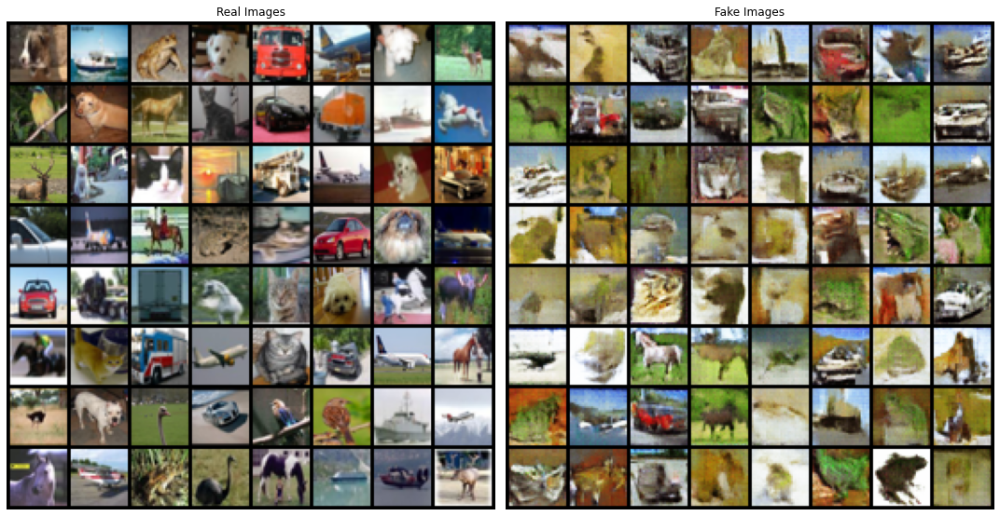

In [ ]:
_, axs = plt.subplots(1,2,figsize=(15,15))
display_images(dataset.train_loader,ax = axs[0])
display_images(img_list, ax = axs[1])
plt.tight_layout()

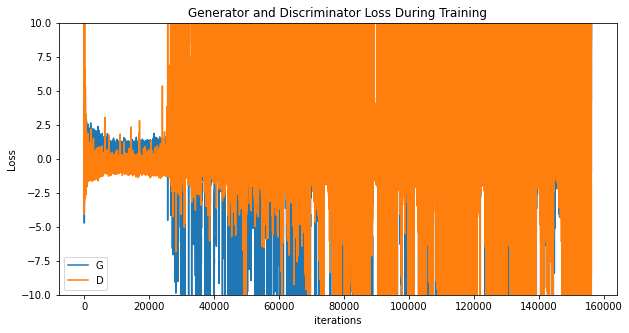

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(loss_logs['gen_loss'],label="G")
plt.plot(loss_logs['dis_loss'],label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.ylim([-10,10])
plt.legend()
plt.show()

Calculating FID Score

In [ ]:
from metrics.torch_is_fid_score import is_fid_from_generator
stat_path = Path('fid_stats/cifar_10_valid_fid_stats.npz')
inception_score, fid = is_fid_from_generator(generator=Gen,
                                        latent_dims=latent_dims,
                                        num_imgs=10000,
                                        batch_sz=256,
                                        fid_stat_path = stat_path)

In [ ]:
print(f"\nFID score: {fid}")
print(f"\nIS: {inception_score}")


FID score: 70.82037353515625

IS: (5.735304355621338, 0.18896456062793732)


Animation size has reached 21413643 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


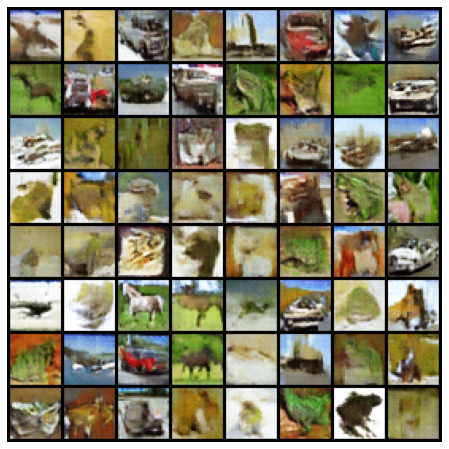

In [ ]:
rc('animation', html='jshtml')
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani